In [13]:
import numpy as np
import pandas as pd
import matplotlib as mpl
import matplotlib.pyplot as plt
import h5py
from mpl_toolkits.axes_grid1 import make_axes_locatable
import os
# from subhalo_count import *

# mpl.rcParams.update(mpl.rcParamsDefault)
plt.style.use('/home/aussing/sty.mplstyle')

# folder  = 'N2048_L65_sd17492' 
# folder  = 'N2048_L65_sd28504'
# folder  = 'N2048_L65_sd34920'
# folder  = 'N2048_L65_sd46371' 'N2048_L65_sd02640' 'N2048_L65_sd05839' ## All simulations with more WDM sats than CDM
# folder  = 'N2048_L65_sd57839'
# folder  = 'N2048_L65_sd61284'
# folder  = 'N2048_L65_sd70562'
# folder  = 'N2048_L65_sd80325'
# folder  = 'N2048_L65_sd93745'

folder  = 'N2048_L65_sd05839'
if not os.path.exists(f'./proj_2/{folder}'):
    os.makedirs(f'./proj_2/{folder}')

In [14]:
UNITMASS = 1e10
LITTLEH = 0.6688
UNIT_LENGTH_FOR_PLOTS = 'Mpc'
npart_min = 20
npart_star_min = 1


In [15]:

def get_extent(halo_pos,extent):

    xmin,xmax  = halo_pos[0]-extent,halo_pos[0]+extent
    ymin,ymax  = halo_pos[1]-extent,halo_pos[1]+extent
    zmin,zmax  = halo_pos[2]-extent,halo_pos[2]+extent
    
    return xmin,xmax,ymin,ymax,zmin,zmax


In [16]:

def make_mask(pos_x,pos_y,pos_z,halo_pos,extent):
    xmin,xmax,ymin,ymax,zmin,zmax = get_extent(halo_pos,extent)
    
    x_mask = (pos_x>=xmin) & (pos_x<=xmax)
    y_mask = (pos_y>=ymin) & (pos_y<=ymax)
    z_mask = (pos_z>=zmin) & (pos_z<=zmax)
    
    pos_mask = x_mask & y_mask & z_mask

    return pos_mask

In [17]:
def get_sim_data(sim_directory,n_file):
    snap_fname     = f'/snapshot_{str(n_file).zfill(3)}.hdf5'
    snap_directory = sim_directory + snap_fname
    snap_data     = h5py.File(snap_directory, 'r')
    
    # haloinfo_fname     = f'/fof_tab_{str(i_file).zfill(3)}.hdf5'
    haloinfo_fname     = f'/fof_subhalo_tab_{str(n_file).zfill(3)}.hdf5'
    haloinfo_directory = sim_directory + haloinfo_fname
    haloinfo_data = h5py.File(haloinfo_directory, 'r')

    z = np.round(snap_data['Header'].attrs['Redshift'],2)
    return snap_data, haloinfo_data, z

In [18]:
def subhalo_data(sim_directory,i_file):
    snap_data, haloinfo_data, z = get_sim_data(sim_directory,i_file)
    z = np.round(z,2)
    # print(z)
    # unit_len = get_unit_len(snap_data)

    halo_pos   = np.array(haloinfo_data['Group']['GroupPos'], dtype=np.float64) #/ LITTLEH
    halo_mass  = np.array(haloinfo_data['Group']['GroupMass'], dtype=np.float64) * UNITMASS / LITTLEH
    halo_M200c = np.array(haloinfo_data['Group']['Group_M_Crit200'], dtype=np.float64) * UNITMASS / LITTLEH
    halo_masstypes = np.array(haloinfo_data['Group']['GroupMassType'], dtype=np.float64) * UNITMASS / LITTLEH
    R200c = np.array(haloinfo_data['Group']['Group_R_Crit200'], dtype=np.float64) #/ LITTLEH

    mass_mask = np.argsort(halo_M200c)[::-1]
    halo_mainID = np.where(halo_masstypes[mass_mask,5] == 0)[0][0]

    # print(f"Redshift = {np.round(z,2)}")
    # print(f"main halo ID = {mass_mask[halo_mainID]}")
    # print(f"Main halo pos = {halo_pos[mass_mask[halo_mainID],:]*LITTLEH}")
    # print(f'M_200c = {np.round(halo_M200c[mass_mask[halo_mainID]]/1e10,3)*LITTLEH}e10 h^-1 Msun')
    # print(f"R_200c = {np.round((R200c[mass_mask[halo_mainID]]),4)*LITTLEH} {UNIT_LENGTH_FOR_PLOTS}") # *unit_len set_plot_len

    main_halo_only = True
    subhalo_halo_num = np.array(haloinfo_data['Subhalo']['SubhaloGroupNr'], dtype=np.float64)
    subhalo_rank       = np.array(haloinfo_data['Subhalo']['SubhaloRankInGr'], dtype=np.int32)

    subhalo_mass       = np.array(haloinfo_data['Subhalo']['SubhaloMass'],dtype=np.float64) * UNITMASS / LITTLEH
    subhalo_mass_type  = np.array(haloinfo_data['Subhalo']['SubhaloMassType'],dtype=np.float64) #* UNITMASS / LITTLEH
    subhalo_len        = np.array(haloinfo_data['Subhalo']['SubhaloLen'],dtype=np.int32)
    subhalo_len_type   = np.array(haloinfo_data['Subhalo']['SubhaloLenType'],dtype=np.int32)
    subhalo_pos        = np.array(haloinfo_data['Subhalo']['SubhaloPos'], dtype=np.float64) / LITTLEH 

    main_halo_subhalos = np.where(subhalo_halo_num==[mass_mask[halo_mainID]])

    subhalo_mass       = subhalo_mass[main_halo_subhalos][subhalo_rank[main_halo_subhalos]!=0] 
    subhalo_mass_type  = subhalo_mass_type[main_halo_subhalos][subhalo_rank[main_halo_subhalos]!=0]
    subhalo_len        = subhalo_len[main_halo_subhalos][subhalo_rank[main_halo_subhalos]!=0]
    subhalo_len_type   = subhalo_len_type[main_halo_subhalos][subhalo_rank[main_halo_subhalos]!=0] 

    subhalo_pos = np.array(haloinfo_data['Subhalo']['SubhaloPos'], dtype=np.float64) / LITTLEH 
    subhalo_pos = subhalo_pos[main_halo_subhalos][subhalo_rank[main_halo_subhalos]!=0]

    # subhalo_pos_dif = subhalo_pos - halo_pos[mass_mask[halo_mainID],:]
    # print(f"subhalo rank 0 - {subhalo_pos[0,:]}")
    # print(f"subhalo rank 1 - {subhalo_pos[1,:]}\n")

    subhalo_dist = []
    for i in range(len(subhalo_pos)):
        # print(positions[i])
        # print((positions-main_halo_pos)[i])
        subhalo_pos_dif = subhalo_pos[i] - halo_pos[mass_mask[halo_mainID],:]
        subhalo_dist.append(np.sqrt(subhalo_pos_dif[0]**2+subhalo_pos_dif[1]**2+subhalo_pos_dif[2]**2))

    subhalo_dist = np.array(subhalo_dist)
    mask_dists = (subhalo_dist>0.01) #& (subhalo_dist<set_plot_len(R200c[mass_mask[halo_mainID]]*unit_len))
    # print(subhalo_dist[mask_dists])
    test = subhalo_dist[mask_dists]

    mask = (subhalo_len>=npart_min) & (subhalo_len_type[:,4]>=npart_star_min) & (subhalo_dist>0.005)  #& (subhalo_dist<set_plot_len(R200c[mass_mask[halo_mainID]]*unit_len))

    # print(mask)
    star_mass              = subhalo_mass_type[mask,4]
    star_mass_ordered      = np.argsort(star_mass)[::-1]
    star_mass              = star_mass[star_mass_ordered][np.where(star_mass[star_mass_ordered]>0)[0]]
    star_mass_sum          = np.cumsum(np.ones(star_mass.shape[0]))
    
    subhalo_radius = np.array(haloinfo_data['Subhalo']['SubhaloHalfmassRad'],dtype=np.float64) #/ LITTLEH #* unit_len
    subhalo_radius = subhalo_radius[main_halo_subhalos][subhalo_rank[main_halo_subhalos]!=0] 
    
    return halo_pos[mass_mask[halo_mainID],:], star_mass_sum, z, subhalo_pos, subhalo_radius, R200c[mass_mask[halo_mainID]], subhalo_mass_type

In [19]:
sim_directory_cdm_005 = f'/fred/oz217/aussing/{folder}/cdm/zoom/output/sn_005/'
sim_directory_cdm_010 = f'/fred/oz217/aussing/{folder}/cdm/zoom/output/sn_010/'

sim_directory_wdm_005 = f'/fred/oz217/aussing/{folder}/wdm_3.5/zoom/output/sn_005/'
sim_directory_wdm_010 = f'/fred/oz217/aussing/{folder}/wdm_3.5/zoom/output/sn_010/'
i_file = 26
halo_pos_cdm_005, star_mass_sum_cdm_005, z, subhalo_pos_cdm_005, subhalo_radius_cdm_005, r_200c_cdm_005, subhalo_mass_type_cdm_005 = subhalo_data(sim_directory_cdm_005,i_file)
halo_pos_cdm_010, star_mass_sum_cdm_010, z, subhalo_pos_cdm_010, subhalo_radius_cdm_010, r_200c_cdm_010, subhalo_mass_type_cdm_010 = subhalo_data(sim_directory_cdm_010,i_file)

halo_pos_wdm_005, star_mass_sum_wdm_005, z, subhalo_pos_wdm_005, subhalo_radius_wdm_005, r_200c_wdm_005, subhalo_mass_type_wdm_005 = subhalo_data(sim_directory_wdm_005,i_file)
# halo_pos_wdm_010, star_mass_sum_wdm_010, z, subhalo_pos_wdm_010, subhalo_radius_wdm_010, r_200c_wdm_010, subhalo_mass_type_wdm_010 = subhalo_data(sim_directory_wdm_010,i_file)

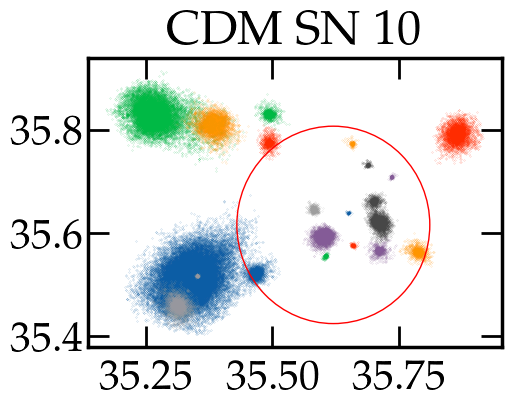

In [20]:
sim_dir_cdm_sn_010 = f'/fred/oz217/aussing/{folder}/cdm/zoom/output/sn_010/'
snap_data_cdm_sn_010, haloinfo_data_cdm_sn_010, z = get_sim_data(sim_dir_cdm_sn_010,i_file)

snap_ids_dm_cdm_sn_010 = snap_data_cdm_sn_010['PartType1']['ParticleIDs']
dm_pos_cdm_sn_010      = snap_data_cdm_sn_010['PartType1']['Coordinates']
# gas_pos_cdm_sn_010     = snap_data_cdm_sn_010['PartType0']['Coordinates']
# star_pos_cdm_sn_010    = snap_data_cdm_sn_010['PartType4']['Coordinates']

subhalo_offset_type_cdm_sn_010 =  np.array(haloinfo_data_cdm_sn_010['Subhalo']['SubhaloOffsetType'], dtype=np.int64)
stel_subhalos_cdm_sn_010 = np.where(subhalo_mass_type_cdm_010[:,4]>0)[0]+1

fig, ax1 = plt.subplots(1,1,figsize=(5,4),dpi=100,layout='constrained')

subhalo_pid_list_cdm_sn_010 = []
for i in stel_subhalos_cdm_sn_010:
# for i in range(1,len(subhalo_mass_type_cdm_010)-1,1):

    sub_id_list = snap_ids_dm_cdm_sn_010[subhalo_offset_type_cdm_sn_010[i,1]:subhalo_offset_type_cdm_sn_010[(i+1),1]]
    subhalo_pid_list_cdm_sn_010.extend(sub_id_list)

    dm_pos_sub_cdm_sn_010 = dm_pos_cdm_sn_010[subhalo_offset_type_cdm_sn_010[i,1]:subhalo_offset_type_cdm_sn_010[(i+1),1]]
    plt.scatter(dm_pos_sub_cdm_sn_010[:,0],dm_pos_sub_cdm_sn_010[:,1], s=0.05,alpha=0.8,marker='.')
    

ax1.add_patch(plt.Circle((halo_pos_cdm_010[0],halo_pos_cdm_010[1]),r_200c_cdm_010, fill=False,color='red',alpha=1))
plt.title('CDM SN 10%')

subhalo_pid_list_cdm_sn_010 = np.array(subhalo_pid_list_cdm_sn_010)
mask_subhalo_pid_cdm_sn_010 = np.isin(snap_ids_dm_cdm_sn_010,subhalo_pid_list_cdm_sn_010)

subhalo_0_pids_cdm_sn_010 = snap_ids_dm_cdm_sn_010[0:subhalo_offset_type_cdm_sn_010[1,1]-1]

group_len_cdm_sn_010 = np.array(haloinfo_data_cdm_sn_010['Group']['GroupLenType'], dtype=np.int64)[0,1]
all_halo_pids_cdm_sn_010 = snap_ids_dm_cdm_sn_010[0:group_len_cdm_sn_010]
# all_halo_pids_cdm_sn_010 = snap_ids_dm_cdm_sn_010[0:subhalo_offset_type_cdm_sn_010[1,0]-1]

 WDM satellite IDS = [ 1  2  3  4  5  6  7  8  9 10 11 12 15 16 21 22 25 29 32 33 36 37 40 53
 68 73]

i = 1
cdm subhalo id = 1, percentage = 87.23%
cdm subhalo id = 7, percentage = 0.02%
cdm subhalo id = 12, percentage = 0.01%
cdm subhalo id = 17, percentage = 0.2%
cdm subhalo id = 30, percentage = 0.01%
cdm subhalo id = 48, percentage = 0.11%
Percentage in CDM Subhalo 0 = 6.15%

Percentage in CDM group = 96.34%
Percentage particles not found = 3.66%

i = 2
cdm subhalo id = 2, percentage = 83.26%
cdm subhalo id = 3, percentage = 1.52%
cdm subhalo id = 9, percentage = 0.37%
Percentage in CDM Subhalo 0 = 4.39%

Percentage in CDM group = 92.05%
Percentage particles not found = 7.95%

i = 3
cdm subhalo id = 2, percentage = 5.37%
cdm subhalo id = 3, percentage = 81.53%
cdm subhalo id = 9, percentage = 0.09%
Percentage in CDM Subhalo 0 = 8.89%

Percentage in CDM group = 96.65%
Percentage particles not found = 3.35%

i = 4
cdm subhalo id = 4, percentage = 85.22%
Percentage in CDM Subhalo 0 =

/tmp/ipykernel_2040536/2747093025.py:26: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig, axs = plt.subplots(1,3,figsize=(18,6),dpi=200,layout='constrained',sharey=True,sharex=True)



i = 36
cdm subhalo id = 5, percentage = 11.43%
Percentage in CDM Subhalo 0 = 68.1%

Percentage in CDM group = 99.52%
Percentage particles not found = 0.48%

i = 37
cdm subhalo id = 1, percentage = 0.96%
Percentage in CDM Subhalo 0 = 15.87%

Percentage in CDM group = 97.6%
Percentage particles not found = 2.4%

i = 40
cdm subhalo id = 36, percentage = 41.08%
Percentage in CDM Subhalo 0 = 55.68%

Percentage in CDM group = 96.76%
Percentage particles not found = 3.24%

i = 53
cdm subhalo id = 100, percentage = 3.96%
Percentage in CDM Subhalo 0 = 91.09%

Percentage in CDM group = 95.05%
Percentage particles not found = 4.95%

i = 68
cdm subhalo id = 1, percentage = 40.32%
Percentage in CDM Subhalo 0 = 22.58%

Percentage in CDM group = 87.1%
Percentage particles not found = 12.9%

i = 73
Percentage in CDM Subhalo 0 = 86.67%

Percentage in CDM group = 100.0%
Percentage particles not found = 0.0%


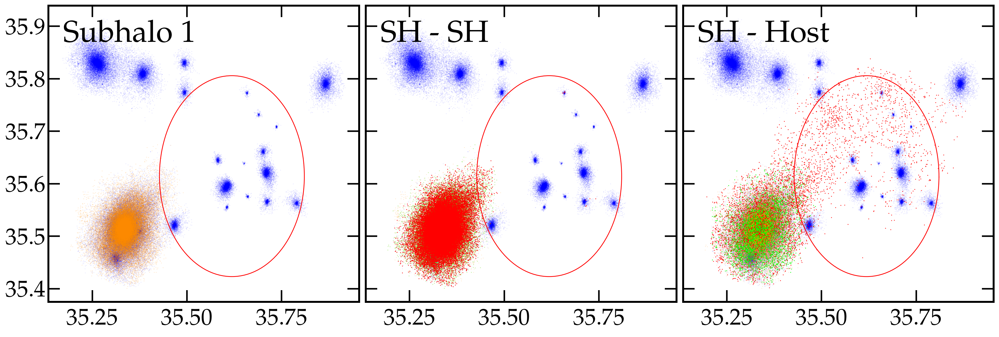

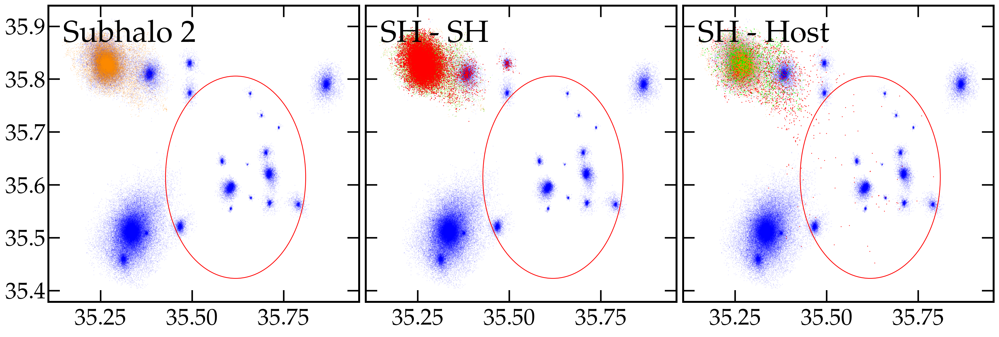

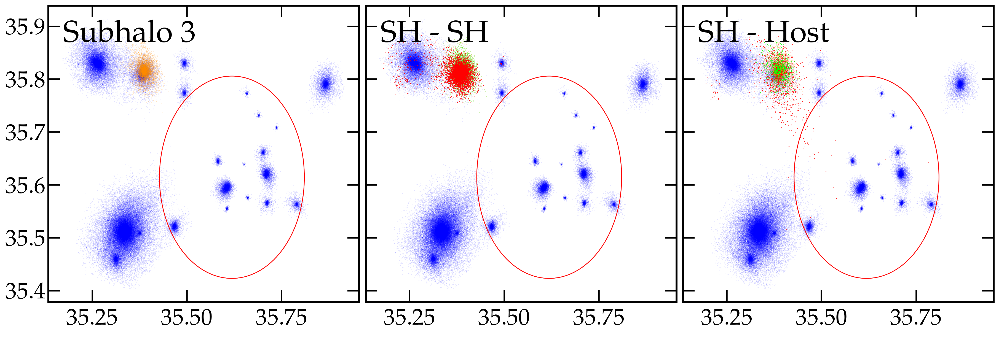

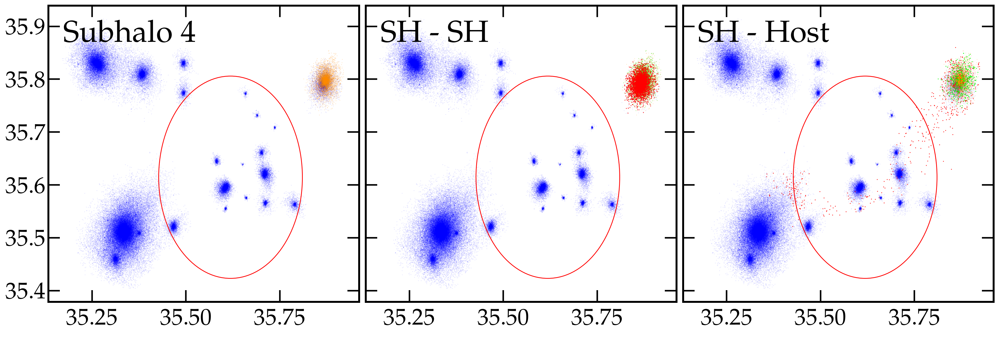

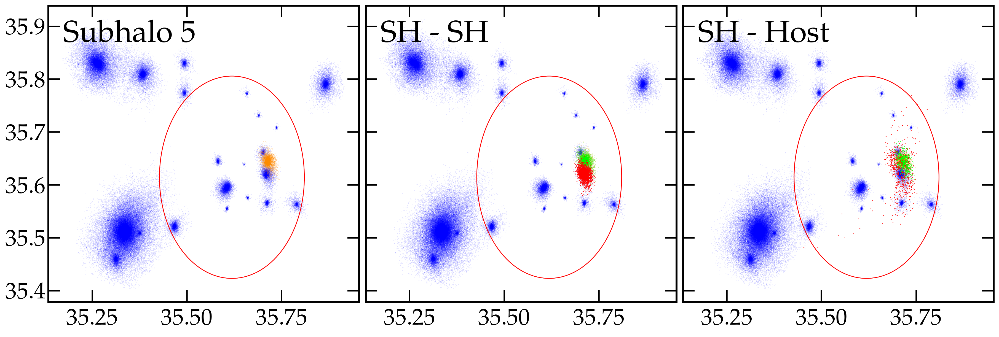

...

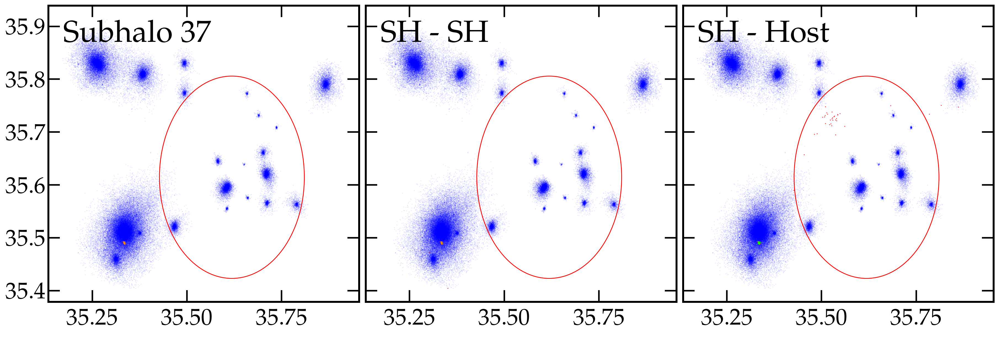

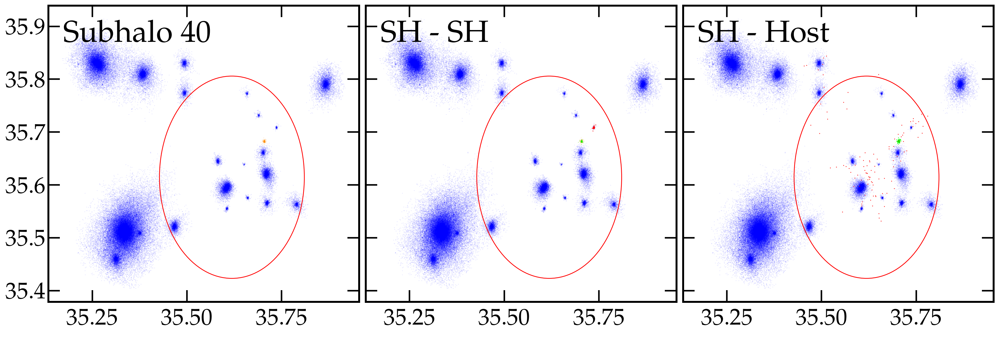

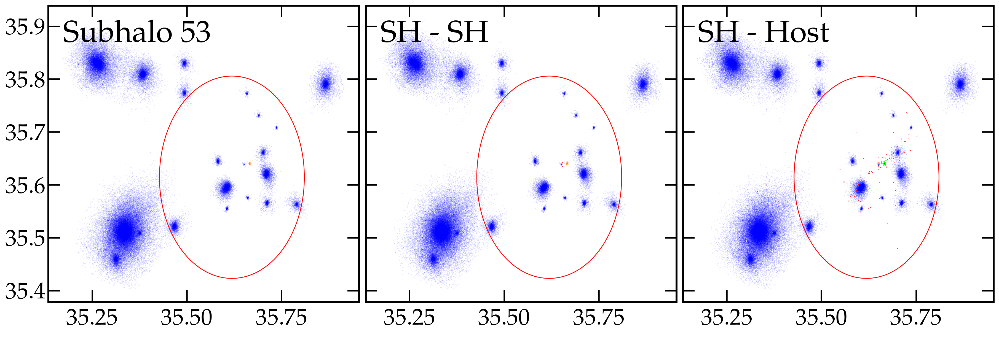

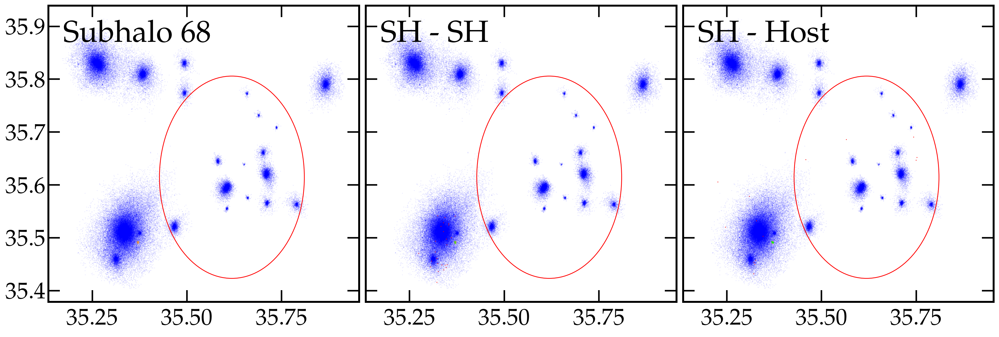

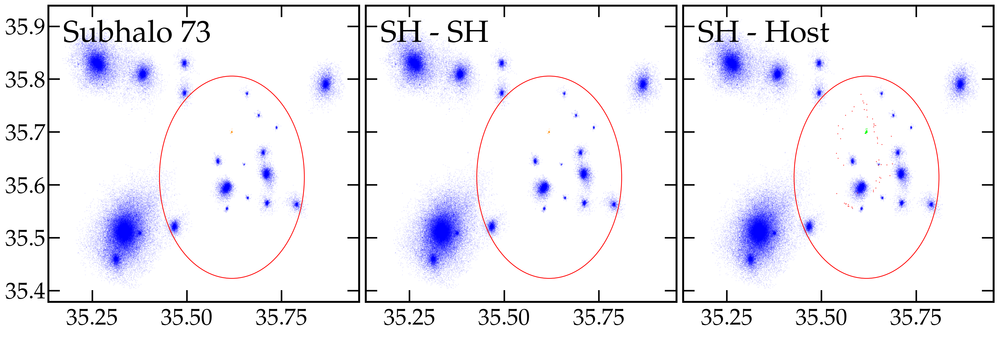

In [21]:
sim_dir_wdm_sn_005 = f'/fred/oz217/aussing/{folder}/wdm_3.5/zoom/output/sn_005/'
snap_data_wdm_sn_005, haloinfo_data_wdm_sn_005, z = get_sim_data(sim_dir_wdm_sn_005,i_file)

snap_ids_dm_wdm_sn_005 = snap_data_wdm_sn_005['PartType1']['ParticleIDs']
dm_pos_wdm_sn_005      = snap_data_wdm_sn_005['PartType1']['Coordinates']
# gas_pos_wdm_sn_005     = snap_data_wdm_sn_005['PartType0']['Coordinates']
# star_pos_wdm_sn_005    = snap_data_wdm_sn_005['PartType4']['Coordinates']

subhalo_offset_type_wdm_sn_005 = np.array(haloinfo_data_wdm_sn_005['Subhalo']['SubhaloOffsetType'], dtype=np.int64)
stel_subhalos_wdm_sn_005 = np.where(subhalo_mass_type_wdm_005[:,4]>0)[0]+1
print(f' WDM satellite IDS = {stel_subhalos_wdm_sn_005}')


subhalo_pid_list_wdm_sn_005 = []
# subhalo_pid_list_wdm_sn_005 = np.zeros(1,dtype=np.uint32)
# start_index, end_index = len(stel_subhalos_wdm_sn_005)-2,len(stel_subhalos_wdm_sn_005)
start_index, end_index = 3,6
num_subhaloes = end_index - start_index # len(stel_subhalos_wdm_sn_005)



# all_wdm_sub_percentge_in_cdm_sub_list = []

for n,i in enumerate(stel_subhalos_wdm_sn_005):
# for i in range(1,len(subhalo_mass_type_wdm_005)-1,1):
    fig, axs = plt.subplots(1,3,figsize=(18,6),dpi=200,layout='constrained',sharey=True,sharex=True)
    print(f'\ni = {i}')

    axs[0].scatter(dm_pos_cdm_sn_010[:,0][mask_subhalo_pid_cdm_sn_010],dm_pos_cdm_sn_010[:,1][mask_subhalo_pid_cdm_sn_010], s=0.05,alpha=0.4,linewidths=0.6,marker='.',color='blue')
    axs[1].scatter(dm_pos_cdm_sn_010[:,0][mask_subhalo_pid_cdm_sn_010],dm_pos_cdm_sn_010[:,1][mask_subhalo_pid_cdm_sn_010], s=0.05,alpha=0.4,linewidths=0.6,marker='.',color='blue')
    axs[2].scatter(dm_pos_cdm_sn_010[:,0][mask_subhalo_pid_cdm_sn_010],dm_pos_cdm_sn_010[:,1][mask_subhalo_pid_cdm_sn_010], s=0.05,alpha=0.4,linewidths=0.6,marker='.',color='blue')
    
    subhalo_pid_list_single_sub = snap_ids_dm_wdm_sn_005[subhalo_offset_type_wdm_sn_005[i,1]:subhalo_offset_type_wdm_sn_005[(i+1),1]]
    subhalo_pid_list_wdm_sn_005.extend(subhalo_pid_list_single_sub[:,])
    # print(len(subhalo_pid_list_wdm_sn_005))
    
    
    dm_pos_sub_wdm_sn_005_single_sub = dm_pos_wdm_sn_005[subhalo_offset_type_wdm_sn_005[i,1]:subhalo_offset_type_wdm_sn_005[(i+1),1]]
    axs[0].scatter(dm_pos_sub_wdm_sn_005_single_sub[:,0],dm_pos_sub_wdm_sn_005_single_sub[:,1], s=0.05,alpha=0.8,linewidths=0.6,marker='.',color='darkorange')
    axs[1].scatter(dm_pos_sub_wdm_sn_005_single_sub[:,0],dm_pos_sub_wdm_sn_005_single_sub[:,1], s=0.05,alpha=0.8,linewidths=0.6,marker='.',color='darkorange')
    axs[2].scatter(dm_pos_sub_wdm_sn_005_single_sub[:,0],dm_pos_sub_wdm_sn_005_single_sub[:,1], s=0.05,alpha=0.8,linewidths=0.6,marker='.',color='darkorange')
    
    mask_wdm_sub_part_in_cdm_subs_single_sub = np.isin(subhalo_pid_list_single_sub,subhalo_pid_list_cdm_sn_010)
    pids_wdm_sub_part_in_cdm_subs_single_sub = np.array(subhalo_pid_list_single_sub)[mask_wdm_sub_part_in_cdm_subs_single_sub]

    mask_all_wdm_part_in_cdm = np.isin(snap_ids_dm_wdm_sn_005,pids_wdm_sub_part_in_cdm_subs_single_sub)
    axs[1].scatter(dm_pos_wdm_sn_005[:,0][mask_all_wdm_part_in_cdm],dm_pos_wdm_sn_005[:,1][mask_all_wdm_part_in_cdm], s=0.1,alpha=0.6,linewidths=0.8,marker='.',color='lime')
    
    # mask_wdm_sub_part_in_cdm_subs = np.isin(subhalo_pid_list_wdm_sn_005,subhalo_pid_list_cdm_sn_010)
    # pids_wdm_sub_part_in_cdm_subs = np.array(subhalo_pid_list_wdm_sn_005)[mask_wdm_sub_part_in_cdm_subs]

    for x in stel_subhalos_cdm_sn_010:
            sub_id_list_cdm_check = snap_ids_dm_cdm_sn_010[subhalo_offset_type_cdm_sn_010[x,1]:subhalo_offset_type_cdm_sn_010[(x+1),1]]
            mask_wdm_sub_in_cdm_sub = np.isin(subhalo_pid_list_single_sub,sub_id_list_cdm_check)

            if np.sum(mask_wdm_sub_in_cdm_sub) > 0:
                # print(np.sum(np.isin(subhalo_pid_list_single_sub,sub_id_list_cdm_check)))
                percentage_cdm_subs = np.round(np.sum(mask_wdm_sub_in_cdm_sub)/len(subhalo_pid_list_single_sub)*100,2)
                print(f'cdm subhalo id = {x}, percentage = {percentage_cdm_subs}%')

                cdm_parts_in_wdm_sub = np.isin(sub_id_list_cdm_check,subhalo_pid_list_single_sub)
                cdm_pos_mask = np.isin(snap_ids_dm_cdm_sn_010,sub_id_list_cdm_check[cdm_parts_in_wdm_sub])                
                axs[1].scatter(dm_pos_cdm_sn_010[:,0][cdm_pos_mask],dm_pos_cdm_sn_010[:,1][cdm_pos_mask], s=0.5,alpha=0.9,linewidths=0.8,marker='.',color='red')
                # axs[2].scatter(dm_pos_cdm_sn_010[:,0][cdm_pos_mask],dm_pos_cdm_sn_010[:,1][cdm_pos_mask], s=0.05,alpha=0.4,linewidths=0.3,marker='.',color='red')
                
            else:
                percentage_cdm_subs = 0
                # print(f'cdm subhalo id = {x}, no particles shared')
    
    mask_wdm_subs_in_cdm_sub_0 =  np.isin(subhalo_pid_list_single_sub,subhalo_0_pids_cdm_sn_010)
    if np.sum(mask_wdm_subs_in_cdm_sub_0)>0 :
        pid_list_wdm_subs_in_cdm_sub_0 = subhalo_pid_list_single_sub[mask_wdm_subs_in_cdm_sub_0]
        cdm_sub_0_in_wdm_sub_mask = np.isin(snap_ids_dm_cdm_sn_010,pid_list_wdm_subs_in_cdm_sub_0)
        wdm_in_cdm_sub_0_mask = np.isin(snap_ids_dm_wdm_sn_005,pid_list_wdm_subs_in_cdm_sub_0)
        axs[2].scatter(dm_pos_wdm_sn_005[:,0][wdm_in_cdm_sub_0_mask],    dm_pos_wdm_sn_005[:,1][wdm_in_cdm_sub_0_mask],     s=0.5,alpha=0.9,linewidths=0.8,marker='.',color='lime')
        axs[2].scatter(dm_pos_cdm_sn_010[:,0][cdm_sub_0_in_wdm_sub_mask],dm_pos_cdm_sn_010[:,1][cdm_sub_0_in_wdm_sub_mask], s=0.5,alpha=0.9,linewidths=0.8,marker='.',color='red')
        
        percentage_cdm_sub_0 = np.round(np.sum(mask_wdm_subs_in_cdm_sub_0)/len(subhalo_pid_list_single_sub)*100,2)
        print(f'Percentage in CDM Subhalo 0 = {percentage_cdm_sub_0}%')

    mask_wdm_sub_in_cdm_group = np.isin(subhalo_pid_list_single_sub,all_halo_pids_cdm_sn_010)
    if np.sum(mask_wdm_sub_in_cdm_group)>0 :
        percentage_cdm_group = np.round(np.sum(mask_wdm_sub_in_cdm_group)/len(subhalo_pid_list_single_sub)*100,2)
        print(f'\nPercentage in CDM group = {percentage_cdm_group}%')
        print(f'Percentage particles not found = {np.round(100-percentage_cdm_group,2)}%')
    else:
        print('\nNo particles in CDM group')

    axs[0].add_patch(plt.Circle((halo_pos_wdm_005[0],halo_pos_wdm_005[1]),r_200c_wdm_005, fill=False,color='red',alpha=1))
    axs[1].add_patch(plt.Circle((halo_pos_wdm_005[0],halo_pos_wdm_005[1]),r_200c_wdm_005, fill=False,color='red',alpha=1))
    axs[2].add_patch(plt.Circle((halo_pos_wdm_005[0],halo_pos_wdm_005[1]),r_200c_wdm_005, fill=False,color='red',alpha=1))

    axs[0].text(0.05,0.95, f'Subhalo {i}',ha='left', va='top',transform=axs[0].transAxes,fontsize=40.0,weight='bold',color='k')
    axs[1].text(0.05,0.95, 'SH - SH',     ha='left', va='top',transform=axs[1].transAxes,fontsize=40.0,weight='bold',color='k')
    axs[2].text(0.05,0.95, 'SH - Host',   ha='left', va='top',transform=axs[2].transAxes,fontsize=40.0,weight='bold',color='k')
    
    # axs[0].set_title(f'WDM Subhalo {i}')
    # axs[1].set_title(f'Particles in CDM subhalo ')
    # axs[2].set_title(f'Particles in CDM Host')
    plt.savefig(f'./proj_2/{folder}/wdm_sub_in_cdm_{i}.png')
    
subhalo_pid_list_wdm_sn_005 = np.array(subhalo_pid_list_wdm_sn_005)
mask_subhalo_pid_wdm_sn_005 = np.isin(snap_ids_dm_wdm_sn_005,subhalo_pid_list_wdm_sn_005)


In [22]:
sim_dir_wdm_sn_005 = f'/fred/oz217/aussing/{folder}/wdm_3.5/zoom/output/sn_005/'
snap_data_wdm_sn_005, haloinfo_data_wdm_sn_005, z = get_sim_data(sim_dir_wdm_sn_005,i_file)

snap_ids_dm_wdm_sn_005 = snap_data_wdm_sn_005['PartType1']['ParticleIDs']
dm_pos_wdm_sn_005      = snap_data_wdm_sn_005['PartType1']['Coordinates']

subhalo_offset_type_wdm_sn_005 = np.array(haloinfo_data_wdm_sn_005['Subhalo']['SubhaloOffsetType'], dtype=np.int64)
stel_subhalos_wdm_sn_005 = np.where(subhalo_mass_type_wdm_005[:,4]>0)[0]+1
print(f' WDM satellite IDS = {stel_subhalos_wdm_sn_005}')
stellar_mass_wdm_005        = subhalo_mass_type_wdm_005[:,4]

subhalo_pid_list_wdm_sn_005 = []
start_index, end_index = 0,len(stel_subhalos_wdm_sn_005)
num_subhaloes = end_index - start_index # len(stel_subhalos_wdm_sn_005)
all_wdm_sub_percentge_in_cdm_sub_list = []
satellite_particle_len = []

for n,i in enumerate(stel_subhalos_wdm_sn_005[start_index:end_index]):
    print(f'\ni = {i}, stellar mass = {(stellar_mass_wdm_005[i-1]*1e10):.2e} h^-1 Msun')
    
    subhalo_pid_list_single_sub = snap_ids_dm_wdm_sn_005[subhalo_offset_type_wdm_sn_005[i,1]:subhalo_offset_type_wdm_sn_005[(i+1),1]]
    subhalo_pid_list_wdm_sn_005.extend(subhalo_pid_list_single_sub[:,])
    satellite_particle_len.append(len(subhalo_pid_list_single_sub))
    print(f'Total number of particles = {len(subhalo_pid_list_single_sub)}')


    dm_pos_sub_wdm_sn_005_single_sub = dm_pos_wdm_sn_005[subhalo_offset_type_wdm_sn_005[i,1]:subhalo_offset_type_wdm_sn_005[(i+1),1]]
    
    single_wdm_sub_percentge_in_cdm_sub_list = []
    # mask_wdm_sub_part_in_cdm_subs = np.isin(subhalo_pid_list_wdm_sn_005,subhalo_pid_list_cdm_sn_010)
    # pids_wdm_sub_part_in_cdm_subs = np.array(subhalo_pid_list_wdm_sn_005)[mask_wdm_sub_part_in_cdm_subs]
    
    wdm_sub_in_cdm_group = np.isin(subhalo_pid_list_single_sub,all_halo_pids_cdm_sn_010)
    percentage_cdm_group = np.round(np.sum(wdm_sub_in_cdm_group)/len(subhalo_pid_list_single_sub)*100,2)
    single_wdm_sub_percentge_in_cdm_sub_list.append(percentage_cdm_group)
    
    if np.sum(wdm_sub_in_cdm_group)>0 :        
        print(f'Percentage in CDM group = {percentage_cdm_group}%')
        # print(f'Percentage particles not found = {np.round(100-percentage_cdm_group,2)}%\n')
    else:
        print('No particles in CDM group')

    wdm_subs_pid_in_cdm_sub_0 =  np.isin(subhalo_pid_list_single_sub,subhalo_0_pids_cdm_sn_010)
    percentage_cdm_sub_0 = np.round(np.sum(wdm_subs_pid_in_cdm_sub_0)/len(subhalo_pid_list_single_sub)*100,2)
    single_wdm_sub_percentge_in_cdm_sub_list.append(percentage_cdm_sub_0)

    if np.sum(wdm_subs_pid_in_cdm_sub_0)>0 :
        print(f'Percentage in CDM Subhalo 0 = {percentage_cdm_sub_0}%')

    for x in stel_subhalos_cdm_sn_010:
            sub_id_list_cdm_check = snap_ids_dm_cdm_sn_010[subhalo_offset_type_cdm_sn_010[x,1]:subhalo_offset_type_cdm_sn_010[(x+1),1]]
            wdm_sub_in_cdm_sub = np.isin(subhalo_pid_list_single_sub,sub_id_list_cdm_check)
            percentage_cdm_subs = np.round(np.sum(wdm_sub_in_cdm_sub)/len(subhalo_pid_list_single_sub)*100,2)
            single_wdm_sub_percentge_in_cdm_sub_list.append(percentage_cdm_subs)
            if np.sum(wdm_sub_in_cdm_sub) > 0:                                
                print(f'cdm subhalo id = {x}, percentage = {percentage_cdm_subs}%')
                cdm_parts_in_wdm_sub = np.isin(sub_id_list_cdm_check,subhalo_pid_list_single_sub)
                cdm_pos_mask = np.isin(snap_ids_dm_cdm_sn_010,sub_id_list_cdm_check[cdm_parts_in_wdm_sub])                

    all_wdm_sub_percentge_in_cdm_sub_list.append(single_wdm_sub_percentge_in_cdm_sub_list)
    
    mask_wdm_sub_part_in_cdm_subs_single_sub = np.isin(subhalo_pid_list_single_sub,subhalo_pid_list_cdm_sn_010)
    pids_wdm_sub_part_in_cdm_subs_single_sub = np.array(subhalo_pid_list_single_sub)[mask_wdm_sub_part_in_cdm_subs_single_sub]

    mask_all_wdm_part_in_cdm = np.isin(snap_ids_dm_wdm_sn_005,pids_wdm_sub_part_in_cdm_subs_single_sub)

all_wdm_sub_percentge_in_cdm_sub_list = np.array(all_wdm_sub_percentge_in_cdm_sub_list)

subhalo_pid_list_wdm_sn_005 = np.array(subhalo_pid_list_wdm_sn_005)
mask_subhalo_pid_wdm_sn_005 = np.isin(snap_ids_dm_wdm_sn_005,subhalo_pid_list_wdm_sn_005)

satellite_particle_len = np.array(satellite_particle_len)


 WDM satellite IDS = [ 1  2  3  4  5  6  7  8  9 10 11 12 15 16 21 22 25 29 32 33 36 37 40 53
 68 73]

i = 1, stellar mass = 1.10e+09 h^-1 Msun
Total number of particles = 66527
Percentage in CDM group = 96.34%
Percentage in CDM Subhalo 0 = 6.15%
cdm subhalo id = 1, percentage = 87.23%
cdm subhalo id = 7, percentage = 0.02%
cdm subhalo id = 12, percentage = 0.01%
cdm subhalo id = 17, percentage = 0.2%
cdm subhalo id = 30, percentage = 0.01%
cdm subhalo id = 48, percentage = 0.11%

i = 2, stellar mass = 2.83e+08 h^-1 Msun
Total number of particles = 27037
Percentage in CDM group = 92.05%
Percentage in CDM Subhalo 0 = 4.39%
cdm subhalo id = 2, percentage = 83.26%
cdm subhalo id = 3, percentage = 1.52%
cdm subhalo id = 9, percentage = 0.37%

i = 3, stellar mass = 3.59e+07 h^-1 Msun
Total number of particles = 7950
Percentage in CDM group = 96.65%
Percentage in CDM Subhalo 0 = 8.89%
cdm subhalo id = 2, percentage = 5.37%
cdm subhalo id = 3, percentage = 81.53%


cdm subhalo id = 9, percentage = 0.09%

i = 4, stellar mass = 5.03e+07 h^-1 Msun
Total number of particles = 6653
Percentage in CDM group = 94.12%
Percentage in CDM Subhalo 0 = 7.4%
cdm subhalo id = 4, percentage = 85.22%

i = 5, stellar mass = 1.17e+08 h^-1 Msun
Total number of particles = 4920
Percentage in CDM group = 99.39%
Percentage in CDM Subhalo 0 = 11.5%
cdm subhalo id = 6, percentage = 85.77%

i = 6, stellar mass = 1.68e+07 h^-1 Msun
Total number of particles = 4319
Percentage in CDM group = 97.8%
Percentage in CDM Subhalo 0 = 3.54%
cdm subhalo id = 1, percentage = 0.09%
cdm subhalo id = 7, percentage = 86.5%

i = 7, stellar mass = 1.09e+08 h^-1 Msun
Total number of particles = 3693
Percentage in CDM group = 99.65%
Percentage in CDM Subhalo 0 = 9.64%
cdm subhalo id = 5, percentage = 88.6%
cdm subhalo id = 15, percentage = 0.03%

i = 8, stellar mass = 3.71e+07 h^-1 Msun
Total number of particles = 3132
Percentage in CDM group = 87.77%
Percentage in CDM Subhalo 0 = 18.45%
cdm s

In [23]:
# print(all_wdm_sub_percentge_in_cdm_sub_list)

# print(all_wdm_sub_percentge_in_cdm_sub_list[:,0],'\n', all_wdm_sub_percentge_in_cdm_sub_list[1,:])
print(stel_subhalos_wdm_sn_005)
# print(np.sum(all_wdm_sub_percentge_in_cdm_sub_list[:,2:],axis=1))
# print(len(all_wdm_sub_percentge_in_cdm_sub_list[:,0]))
print('ID & Sub Len & % found & % not found & % found in Sub 0 & % found in sats')
with open(f'./proj_2/{folder}/summary_wdm_in_cdm.txt', 'w+') as f:
    f.write('ID & Sub Len & % found & % not found & % found in Sub 0 & % found in sats\n')
    for i in range(len(all_wdm_sub_percentge_in_cdm_sub_list[:,0])):
        print(stel_subhalos_wdm_sn_005[i], ' & ' , satellite_particle_len[i], '& ' ,all_wdm_sub_percentge_in_cdm_sub_list[i,0] , ' & ' , np.round(100-all_wdm_sub_percentge_in_cdm_sub_list[i,0],2) , ' & ' , all_wdm_sub_percentge_in_cdm_sub_list[i,1], ' & ' , np.sum(all_wdm_sub_percentge_in_cdm_sub_list[i,2:]), '\\','\\')
        # f.write((stel_subhalos_wdm_sn_005[i], ' & ' , satellite_particle_len[i], '& ' ,all_wdm_sub_percentge_in_cdm_sub_list[i,0] , ' & ' , np.round(100-all_wdm_sub_percentge_in_cdm_sub_list[i,0],2) , ' & ' , all_wdm_sub_percentge_in_cdm_sub_list[i,1], ' & ' , np.sum(all_wdm_sub_percentge_in_cdm_sub_list[i,2:]) ,'\\','\\','\n'))
        f.write(f'{str(stel_subhalos_wdm_sn_005[i])} & {satellite_particle_len[i]}  & {all_wdm_sub_percentge_in_cdm_sub_list[i,0]} & {np.round(100-all_wdm_sub_percentge_in_cdm_sub_list[i,0],2)}  & {all_wdm_sub_percentge_in_cdm_sub_list[i,1]} &  {np.sum(all_wdm_sub_percentge_in_cdm_sub_list[i,2:])} \ \ \n')


[ 1  2  3  4  5  6  7  8  9 10 11 12 15 16 21 22 25 29 32 33 36 37 40 53
 68 73]
ID & Sub Len & % found & % not found & % found in Sub 0 & % found in sats
1  &  66527 &  96.34  &  3.66  &  6.15  &  87.58000000000001 \ \
2  &  27037 &  92.05  &  7.95  &  4.39  &  85.15 \ \
3  &  7950 &  96.65  &  3.35  &  8.89  &  86.99 \ \
4  &  6653 &  94.12  &  5.88  &  7.4  &  85.22 \ \
5  &  4920 &  99.39  &  0.61  &  11.5  &  85.77 \ \
6  &  4319 &  97.8  &  2.2  &  3.54  &  86.59 \ \
7  &  3693 &  99.65  &  0.35  &  9.64  &  88.63 \ \
8  &  3132 &  87.77  &  12.23  &  18.45  &  68.84 \ \
9  &  1675 &  96.0  &  4.0  &  11.28  &  82.21 \ \
10  &  1283 &  95.4  &  4.6  &  3.82  &  91.58 \ \
11  &  1273 &  97.64  &  2.36  &  17.75  &  72.03 \ \
12  &  1113 &  86.52  &  13.48  &  14.91  &  71.61 \ \
15  &  695 &  99.14  &  0.86  &  9.78  &  87.91 \ \
16  &  610 &  93.77  &  6.23  &  1.48  &  88.52 \ \
21  &  433 &  98.38  &  1.62  &  75.98  &  22.4 \ \
22  &  417 &  100.0  &  0.0  &  2.64  &  97.36 \ 

In [24]:
# stellar_mass_cdm_010         = subhalo_mass_type_cdm_010[:,1]*UNITMASS/LITTLEH
# stellar_mass_ordered_cdm_010 = np.sort(stellar_mass_cdm_010[stellar_mass_cdm_010>0])[::-1]
# stellar_mass_ordered_cdm_010 = stellar_mass_ordered_cdm_010[0:11]
# stellar_mass_sum_cdm_010     = np.cumsum(np.ones(stellar_mass_ordered_cdm_010.shape))

# stellar_mass_wdm_005        = subhalo_mass_type_wdm_005[:,1]*UNITMASS/LITTLEH
# stellar_mass_wdm_005_sorted = np.sort(stellar_mass_wdm_005[stellar_mass_wdm_005>0])[::-1]
# stellar_mass_wdm_005_sorted = stellar_mass_wdm_005_sorted[0:11]
# stellar_mass_sum_wdm_005    = np.cumsum(np.ones(stellar_mass_wdm_005_sorted.shape))


# plt.plot(stellar_mass_ordered_cdm_010,stellar_mass_sum_cdm_010,c='b')
# plt.plot(stellar_mass_wdm_005_sorted,stellar_mass_sum_wdm_005,c='orange')

# # plt.ylim
# plt.xscale('log')
# plt.yscale('log')


